In [21]:
import pandas as pd
import numpy as np
from skimage import io
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from tqdm import tqdm
from glob import glob
import os
import torch
from joblib import Parallel, delayed

data_folder = '/home/ubuntu/Thesis/backup_data/bioMass_data/'

%matplotlib inline

# EDA Questions

1. Distribution of month availability
2. Small visualization of a chip across the year
3. How to deal with no data? More generally: what preprocessing should be used?

In [6]:
f = os.path.join(data_folder, 'features_metadata.csv')
train_df = pd.read_csv(f)
train_df = train_df[train_df.split=='train']
print(train_df.shape)

train_df.head()

(189078, 11)


,filename,chip_id,satellite,split,month,size,cksum,s3path_us,s3path_eu,s3path_as,corresponding_agbm
0,0003d2eb_S1_00.tif,0003d2eb,S1,train,September,1049524,3953454613,s3://drivendata-competition-biomassters-public...,s3://drivendata-competition-biomassters-public...,s3://drivendata-competition-biomassters-public...,0003d2eb_agbm.tif
1,0003d2eb_S1_01.tif,0003d2eb,S1,train,October,1049524,3531005382,s3://drivendata-competition-biomassters-public...,s3://drivendata-competition-biomassters-public...,s3://drivendata-competition-biomassters-public...,0003d2eb_agbm.tif
2,0003d2eb_S1_02.tif,0003d2eb,S1,train,November,1049524,1401197002,s3://drivendata-competition-biomassters-public...,s3://drivendata-competition-biomassters-public...,s3://drivendata-competition-biomassters-public...,0003d2eb_agbm.tif
3,0003d2eb_S1_03.tif,0003d2eb,S1,train,December,1049524,3253084255,s3://drivendata-competition-biomassters-public...,s3://drivendata-competition-biomassters-public...,s3://drivendata-competition-biomassters-public...,0003d2eb_agbm.tif
4,0003d2eb_S1_04.tif,0003d2eb,S1,train,January,1049524,2467836265,s3://drivendata-competition-biomassters-public...,s3://drivendata-competition-biomassters-public...,s3://drivendata-competition-biomassters-public...,0003d2eb_agbm.tif


In [138]:
def read_and_process_tif(filename):
    data = io.imread(filename)
    data = np.moveaxis(data, -1, 0)
    # clip top 1% of data ?
    # normalize ?
    
    if '_S2_' in filename:
        nvdi = (data[3]-data[2]) / (data[3]+data[2] + 1e-3) # B5 - B4
        data = np.append(data, nvdi[np.newaxis, ...], axis=0) # band_no: 11

        mndwi = (data[1]-data[3]) / (data[1]+data[3] + 1e-3) # B3 - B5
        data = np.append(data, mndwi[np.newaxis, ...], axis=0) # band_no: 12
        
        evi = 2.5 * data[5] - data[2]/(data[5]+1e-3) + 6 * data[2] - 7.5 * data[0] + 1
        data = np.append(data, evi[np.newaxis, ...], axis=0) # band_no: 13
    
    return data

In [120]:
def plot_months(chip_df, satellite, band_no, cmap='viridis'):
    
    chip_data = chip_df[chip_df.satellite==satellite]
    files_list = chip_data.filename.map(lambda x: os.path.join(data_folder, 'train_features/'+x)).values
    months_list = chip_data.filename.map(lambda x: int(x.split('_')[-1].replace('.tif', ''))).values

    data = Parallel(len(files_list))(delayed(read_and_process_tif)(x) for x in files_list)
    
    fig, ax = plt.subplots(3, 4, sharex=True, sharey=True, figsize=(10, 8))
    plt.suptitle('%s: %s' %(chip_data.chip_id.values[0], satellite))
    list(map(lambda axi: axi.set_axis_off(), ax.ravel()))
    plt.tight_layout()


    for month, month_data in zip(months_list, data):
        col = month%4
        row = month//4
        ax[row][col].imshow(month_data[band_no], cmap=cmap)
        
    plt.show()
    
    return

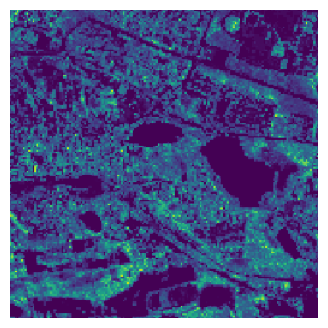

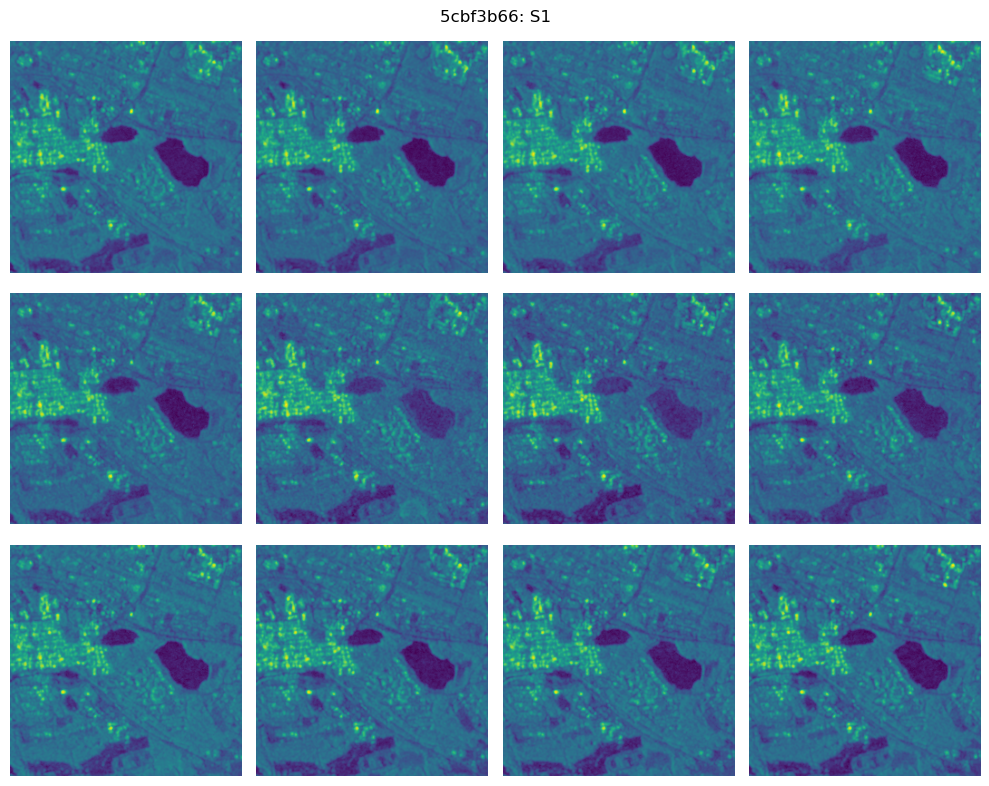

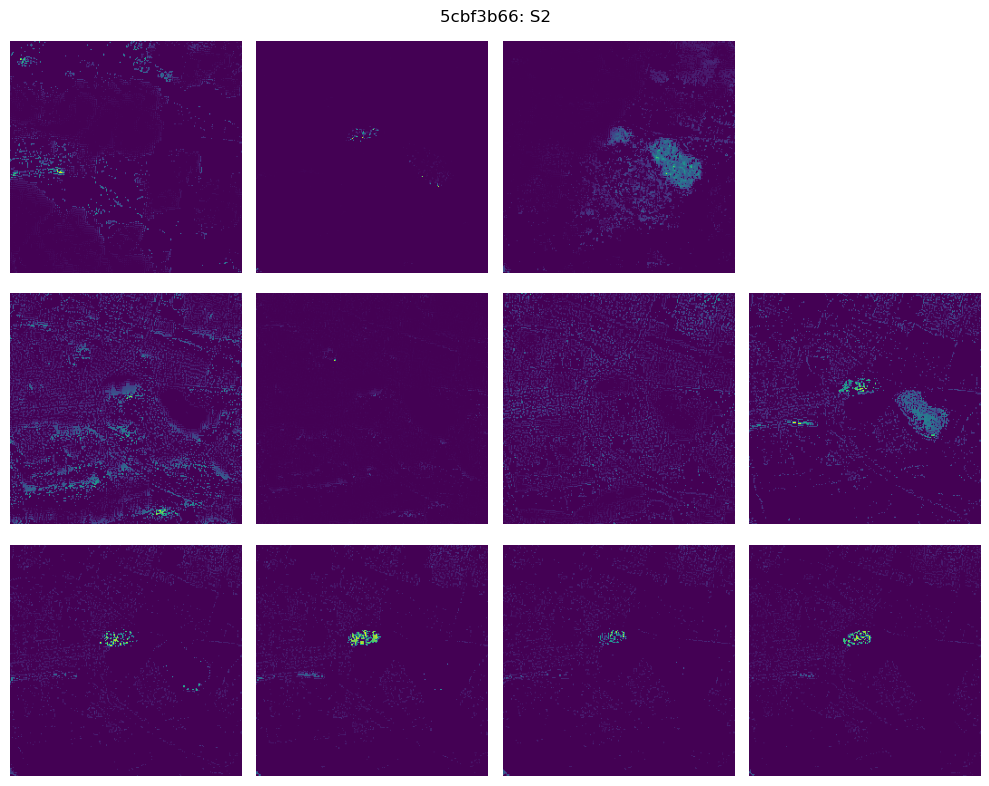

------------------------------------------------------------------------------------------


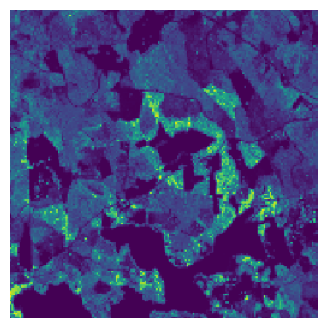

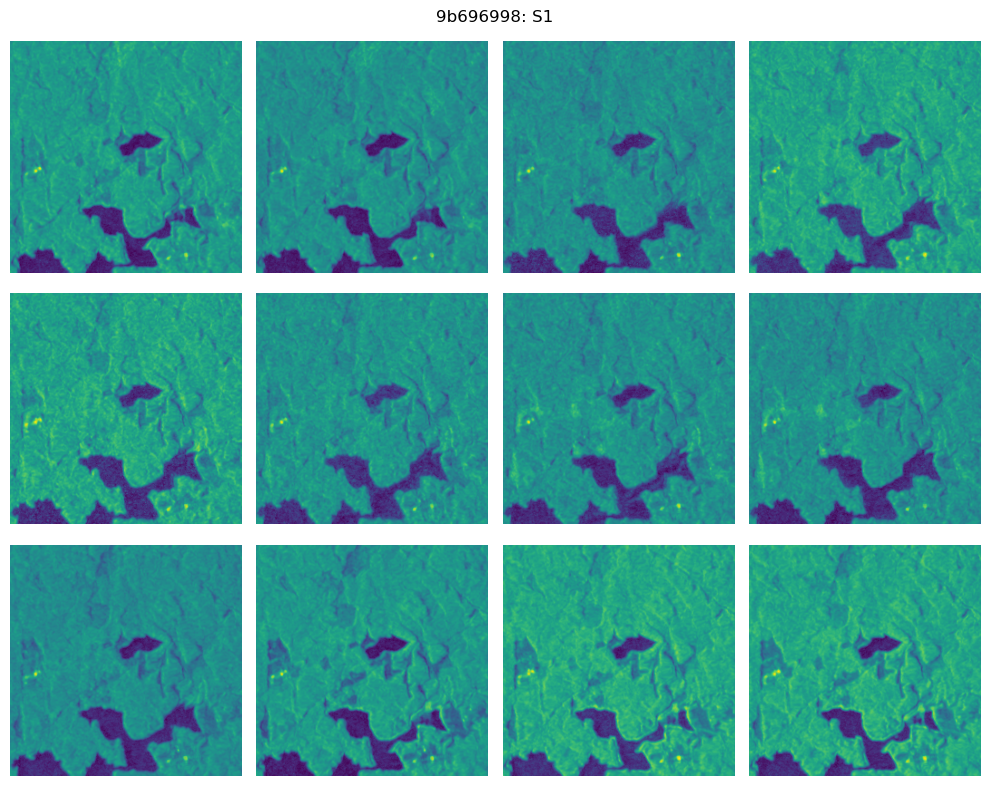

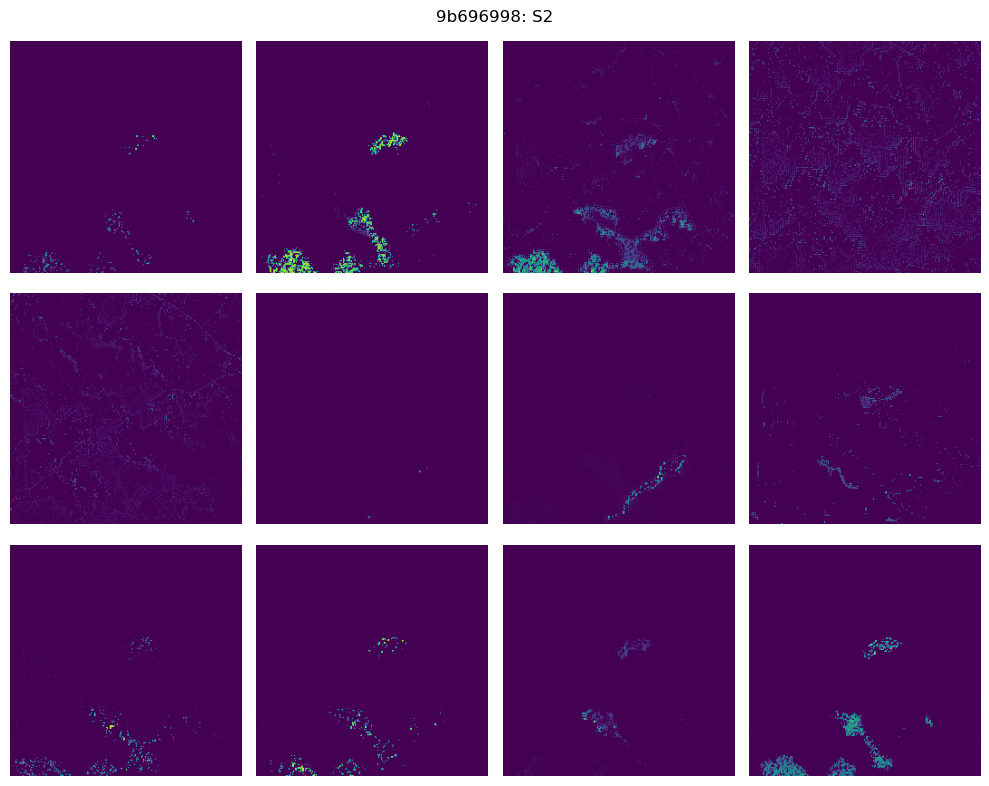

------------------------------------------------------------------------------------------


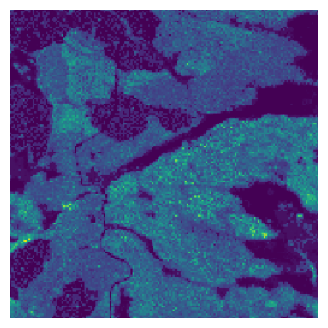

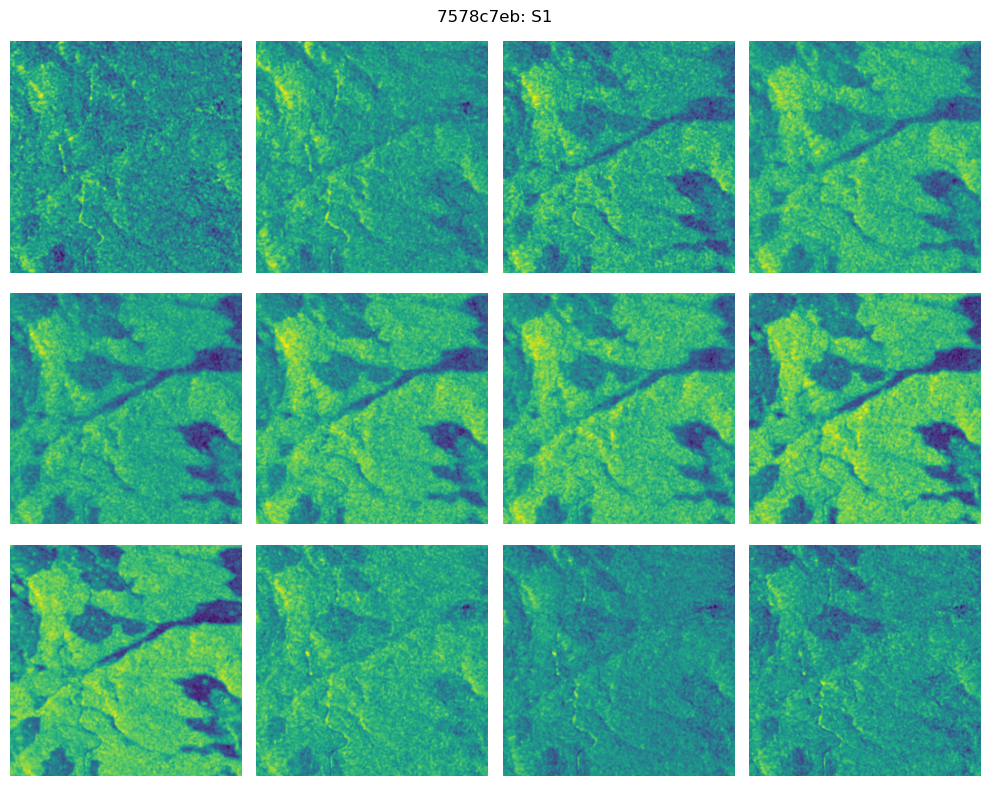

/tmp/ipykernel_4014963/1774939680.py:8: RuntimeWarning: invalid value encountered in divide
/tmp/ipykernel_4014963/1774939680.py:11: RuntimeWarning: invalid value encountered in divide


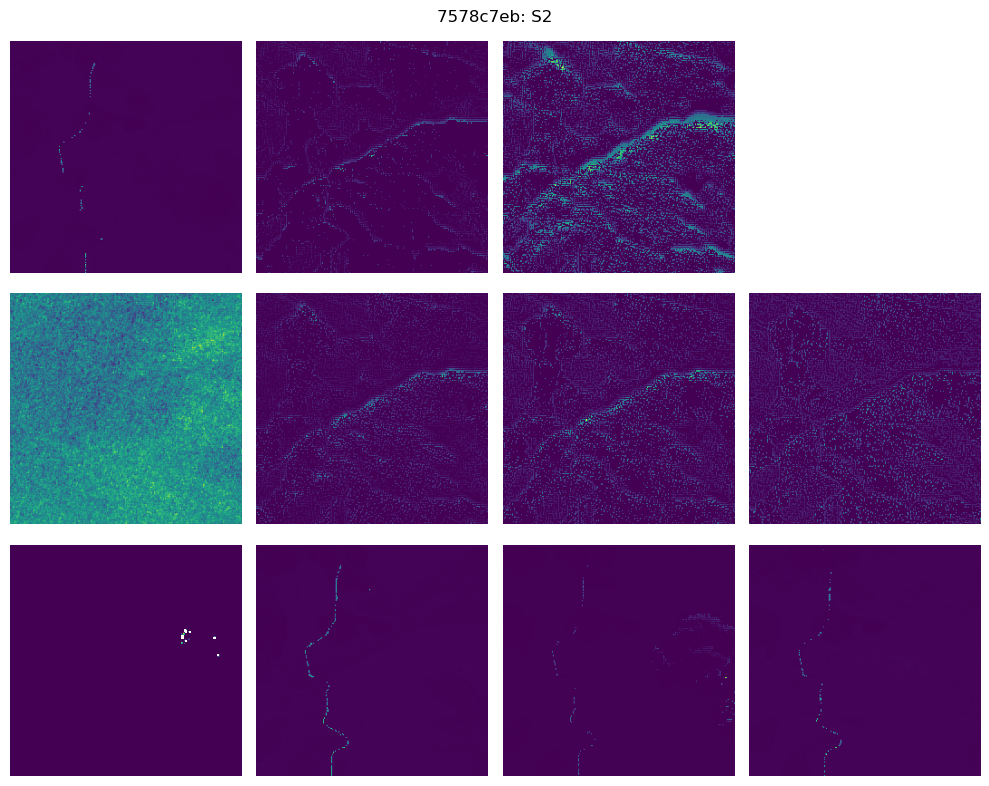

------------------------------------------------------------------------------------------


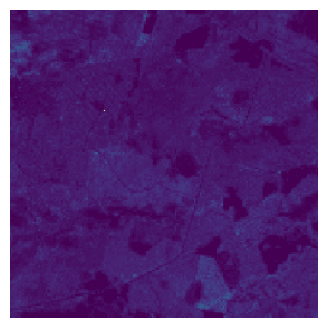

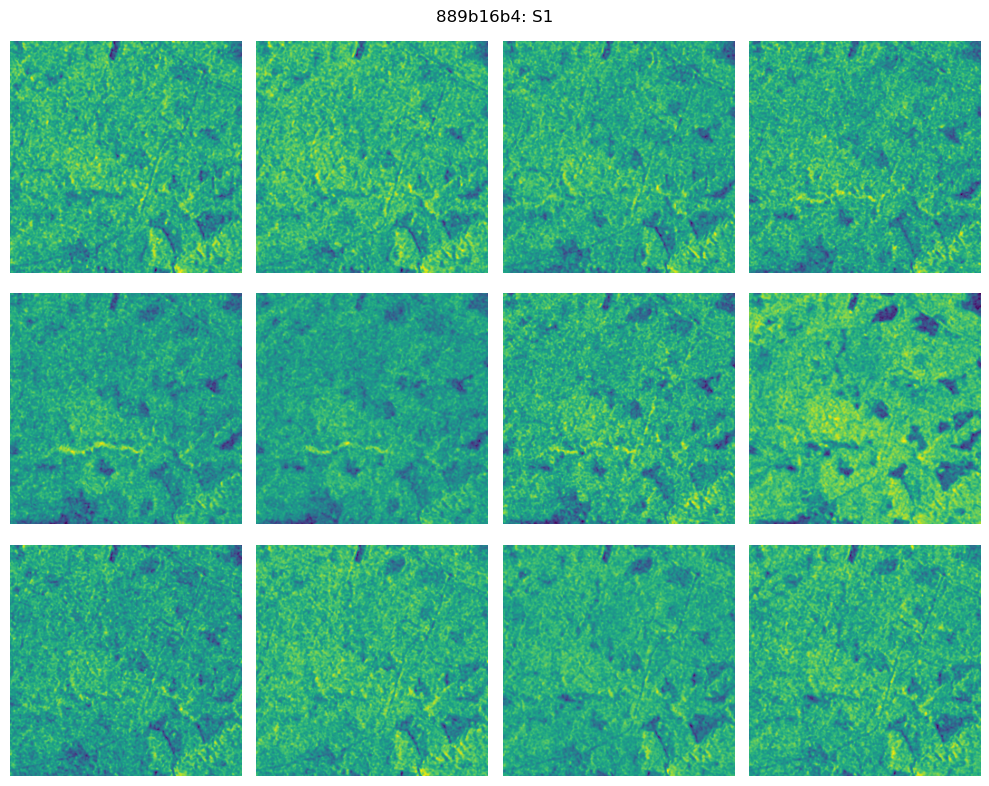

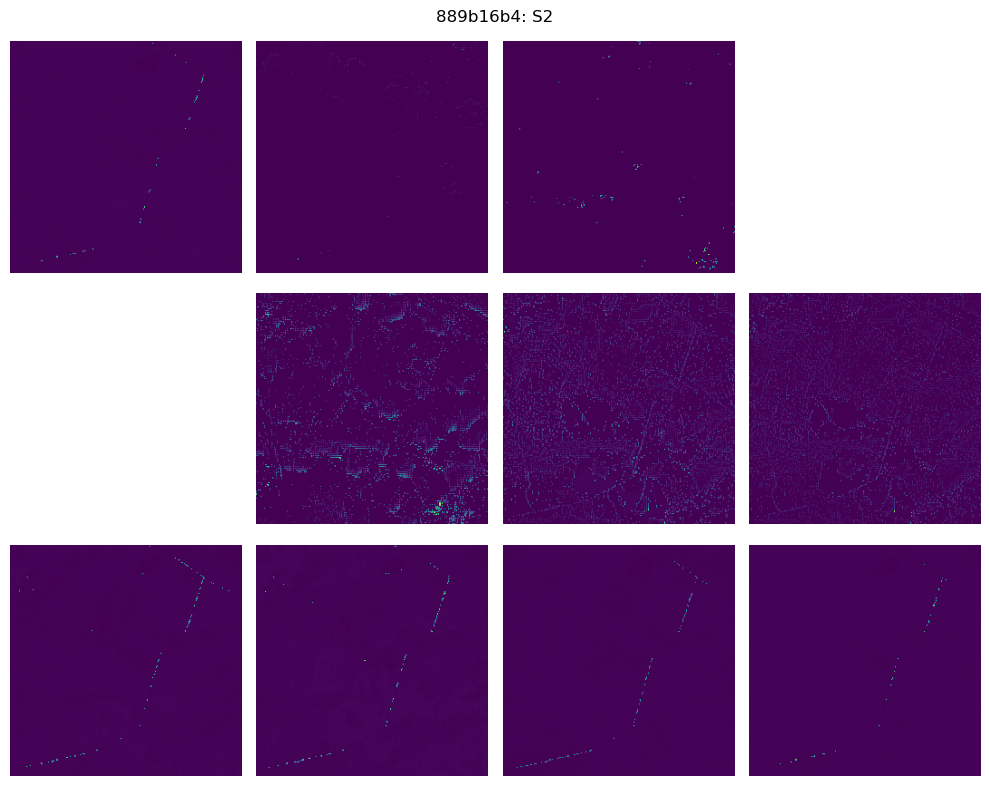

------------------------------------------------------------------------------------------


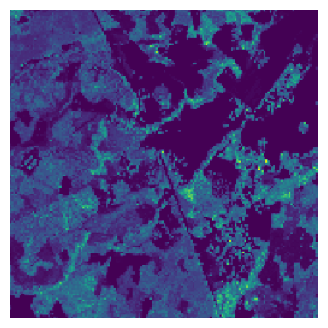

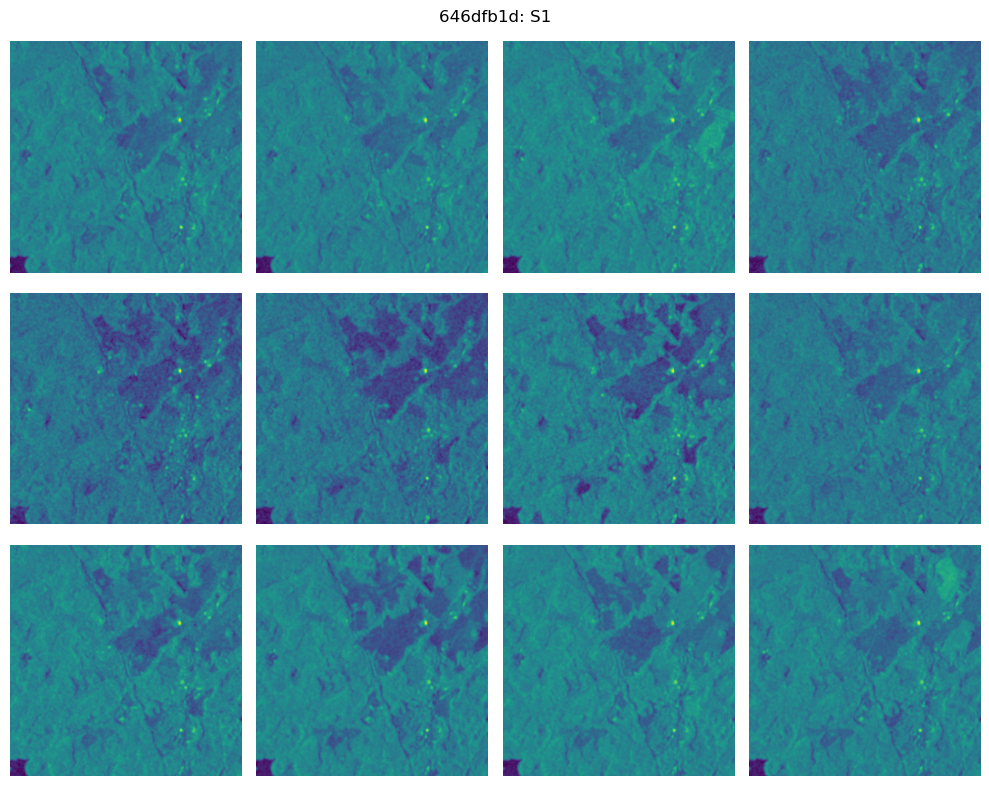

/tmp/ipykernel_4014963/1774939680.py:8: RuntimeWarning: invalid value encountered in divide


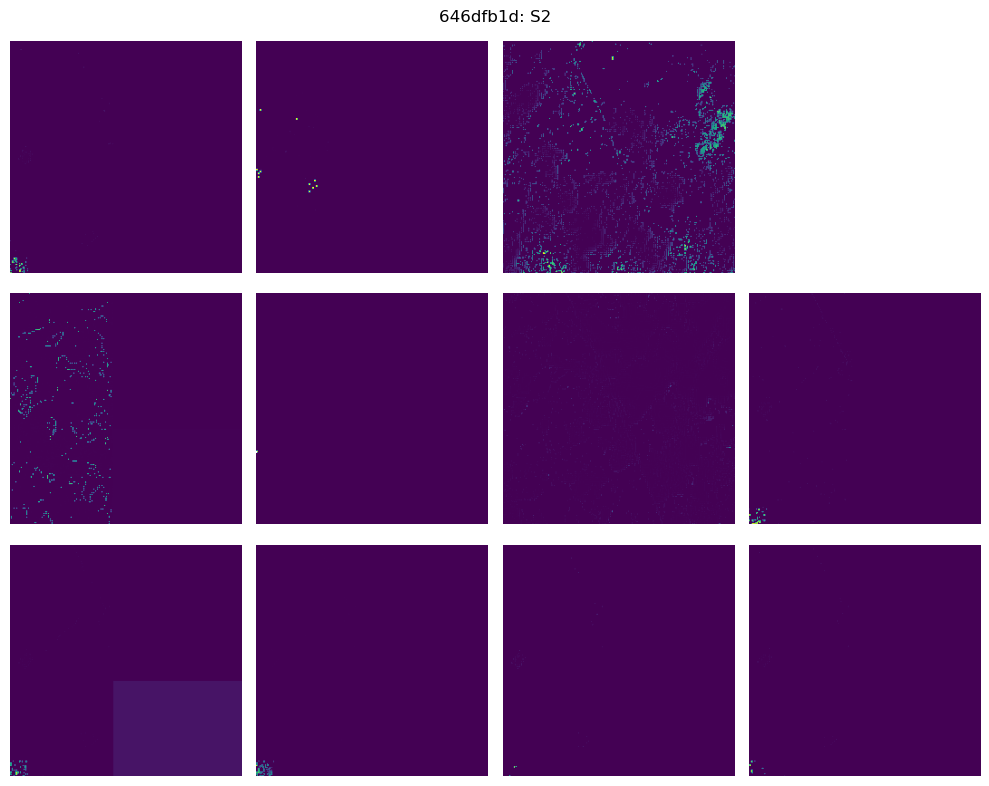

------------------------------------------------------------------------------------------


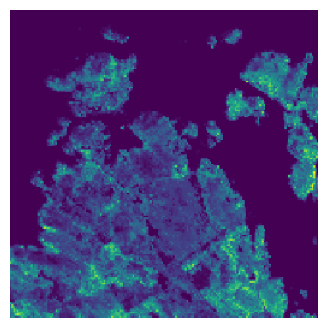

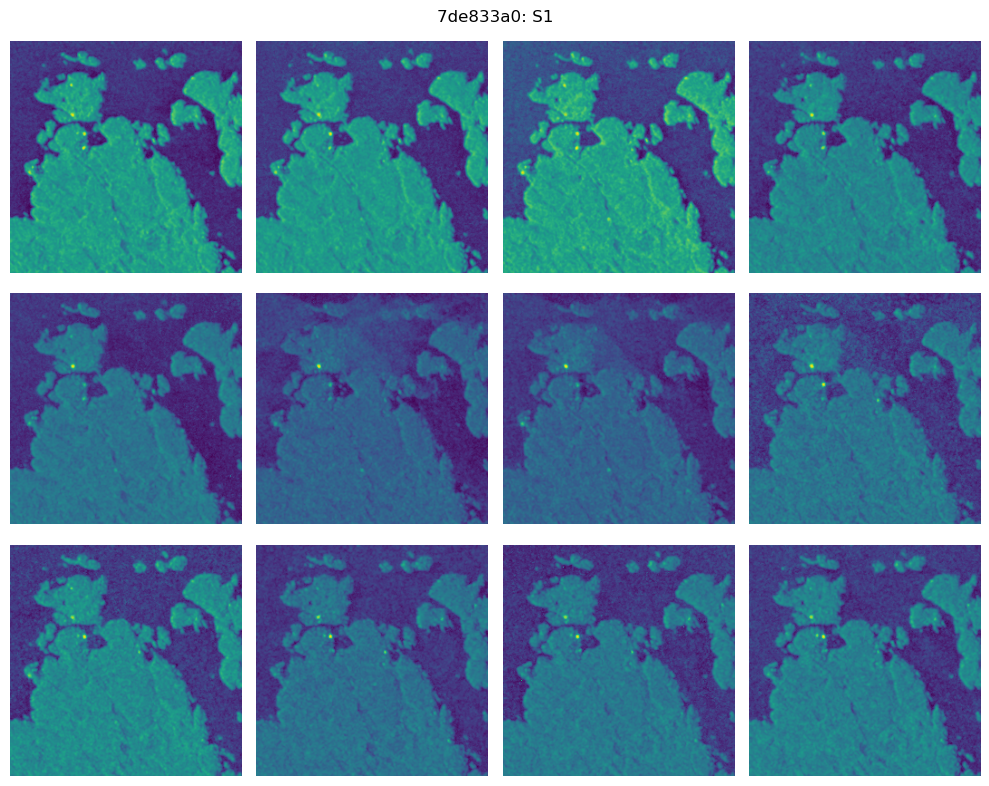

/tmp/ipykernel_4014963/1774939680.py:8: RuntimeWarning: invalid value encountered in divide
/tmp/ipykernel_4014963/1774939680.py:11: RuntimeWarning: invalid value encountered in divide


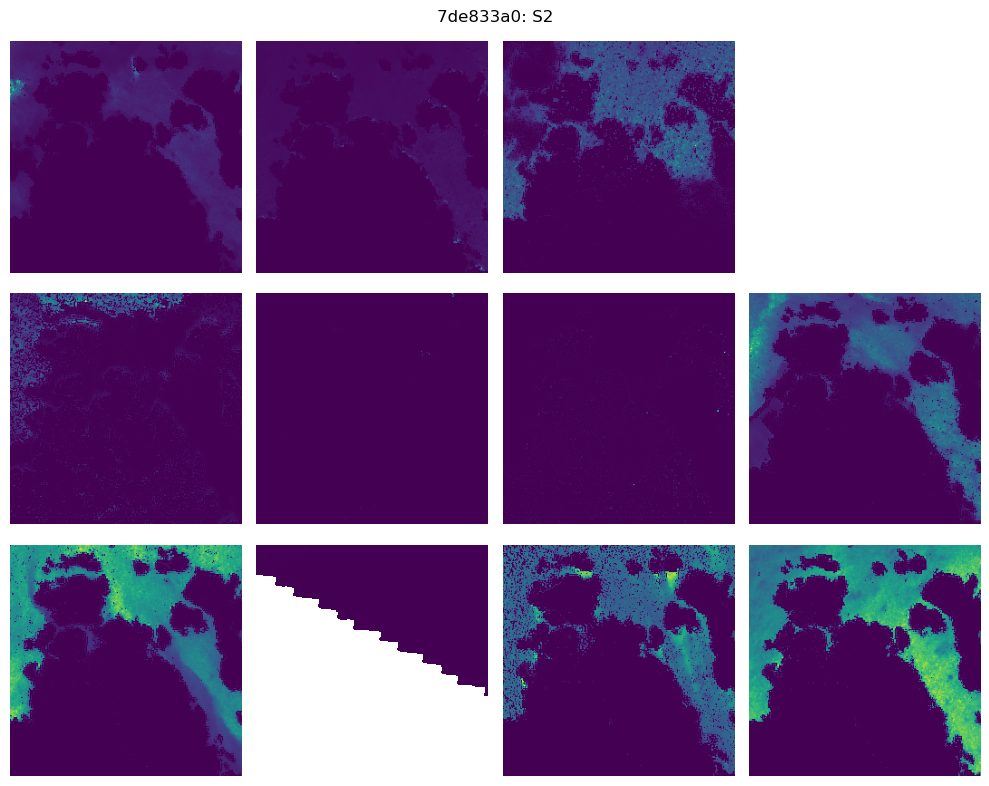

------------------------------------------------------------------------------------------


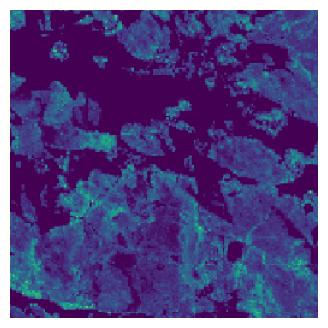

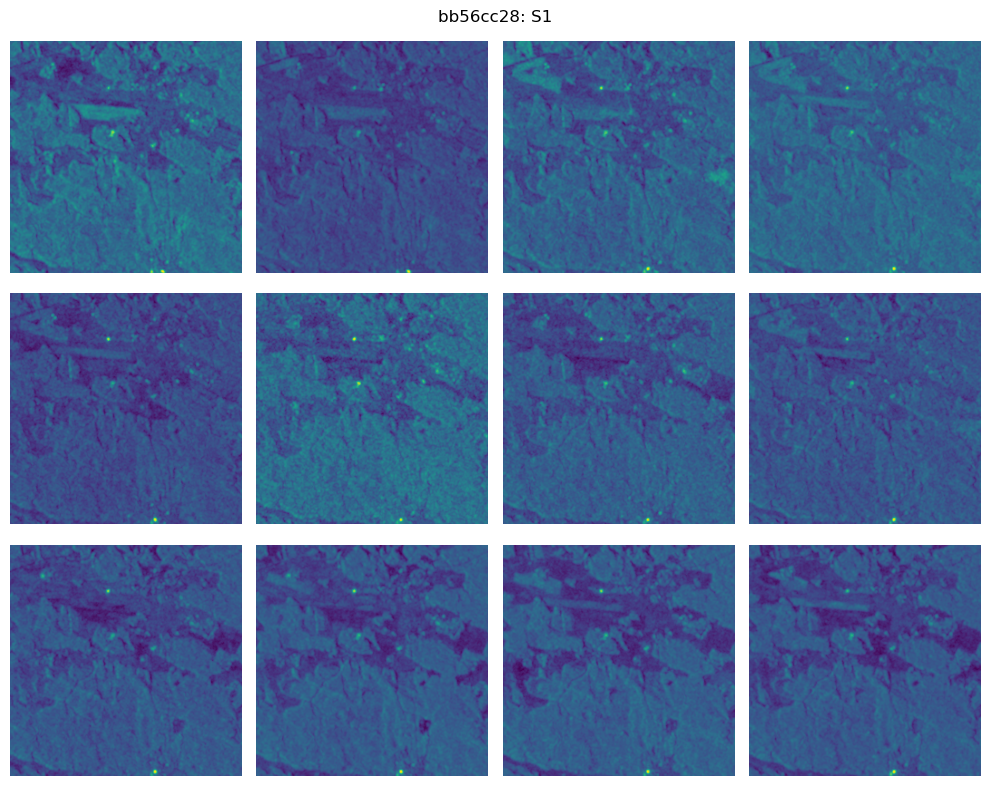

/tmp/ipykernel_4014963/1774939680.py:8: RuntimeWarning: invalid value encountered in divide
/tmp/ipykernel_4014963/1774939680.py:11: RuntimeWarning: invalid value encountered in divide


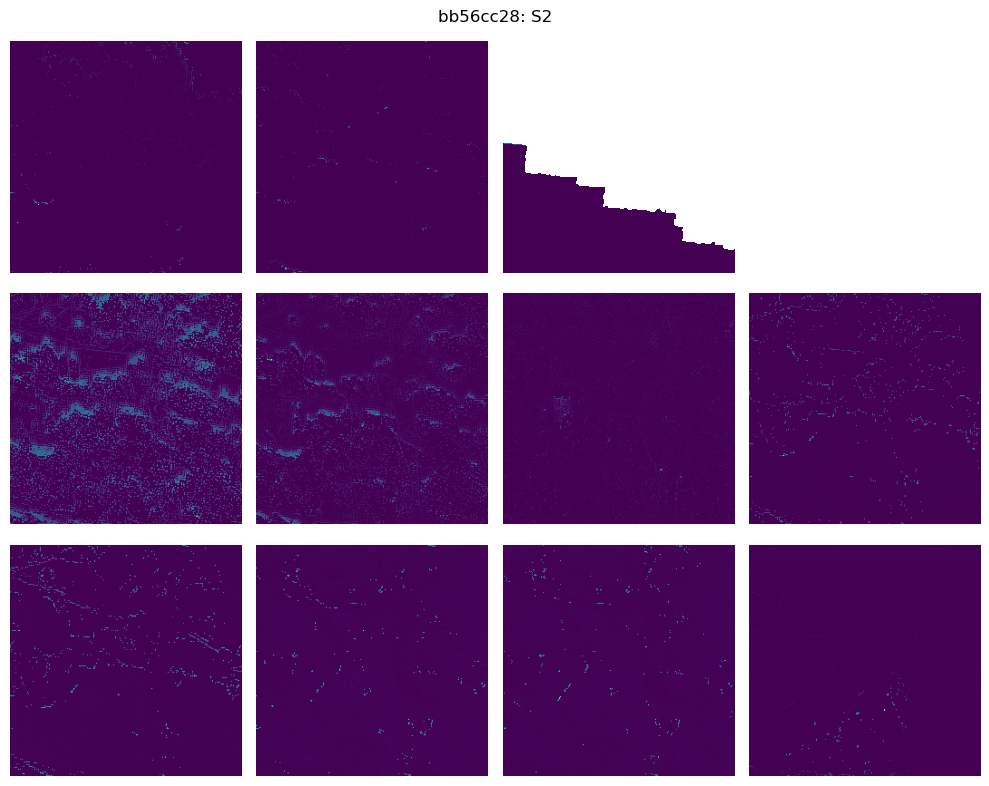

------------------------------------------------------------------------------------------


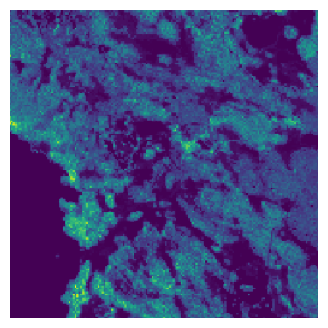

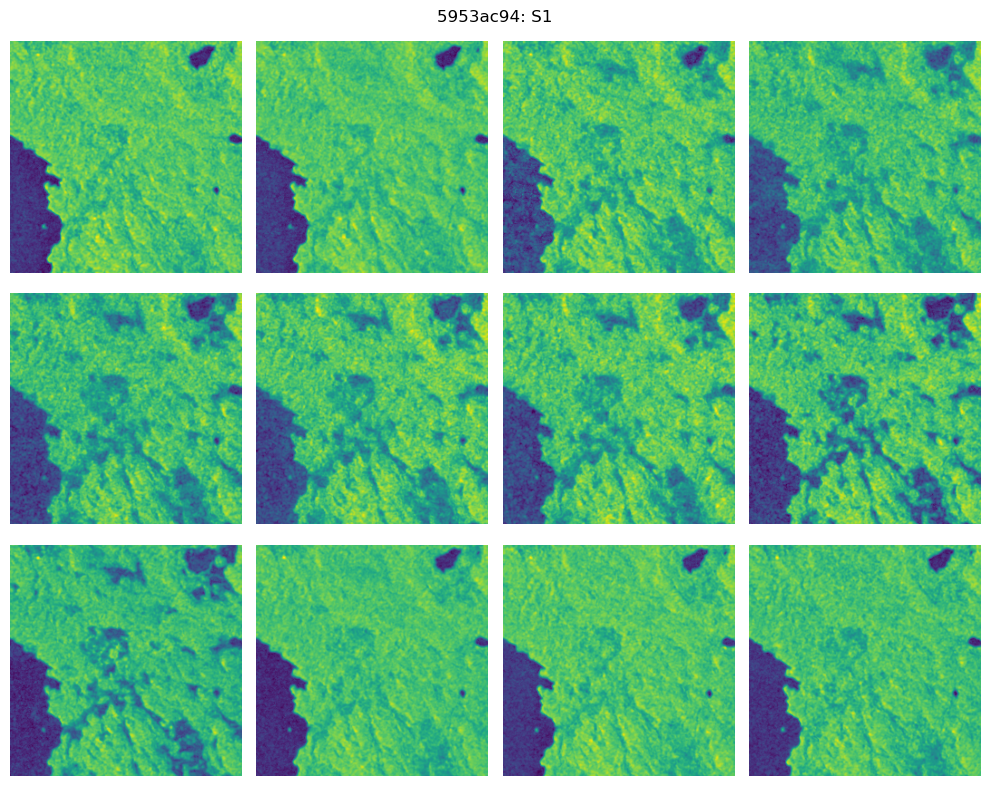

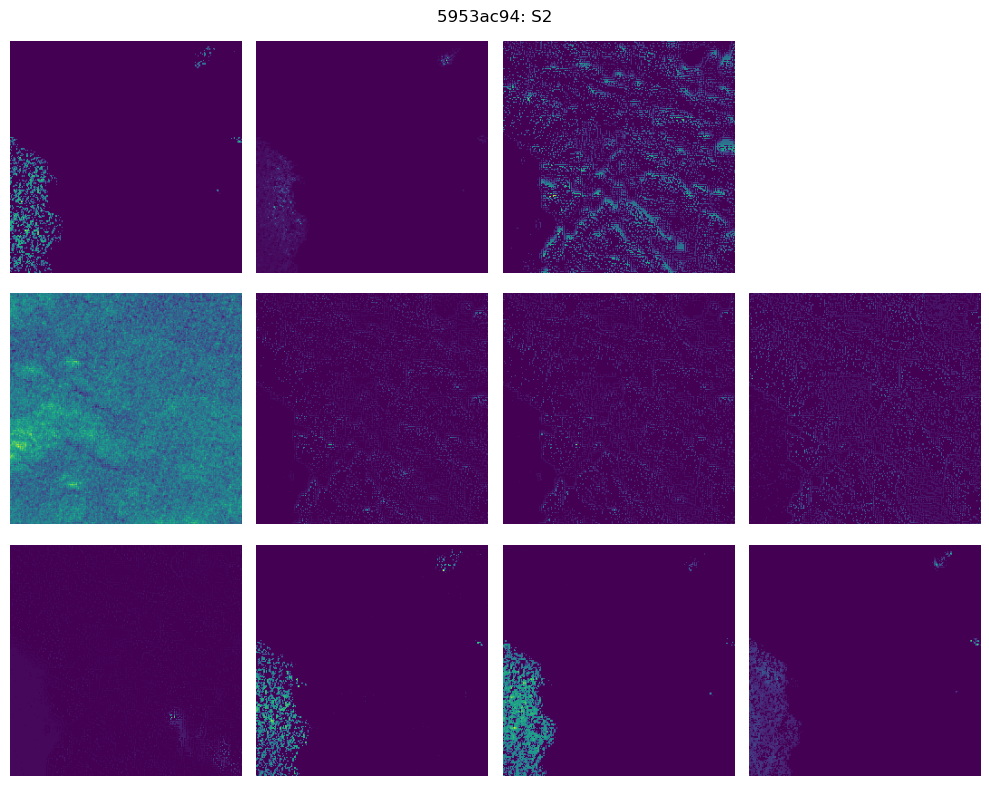

------------------------------------------------------------------------------------------


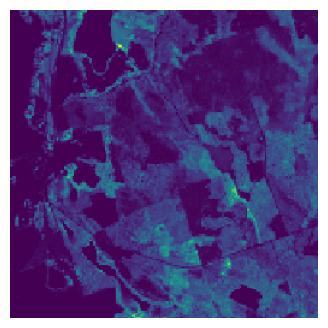

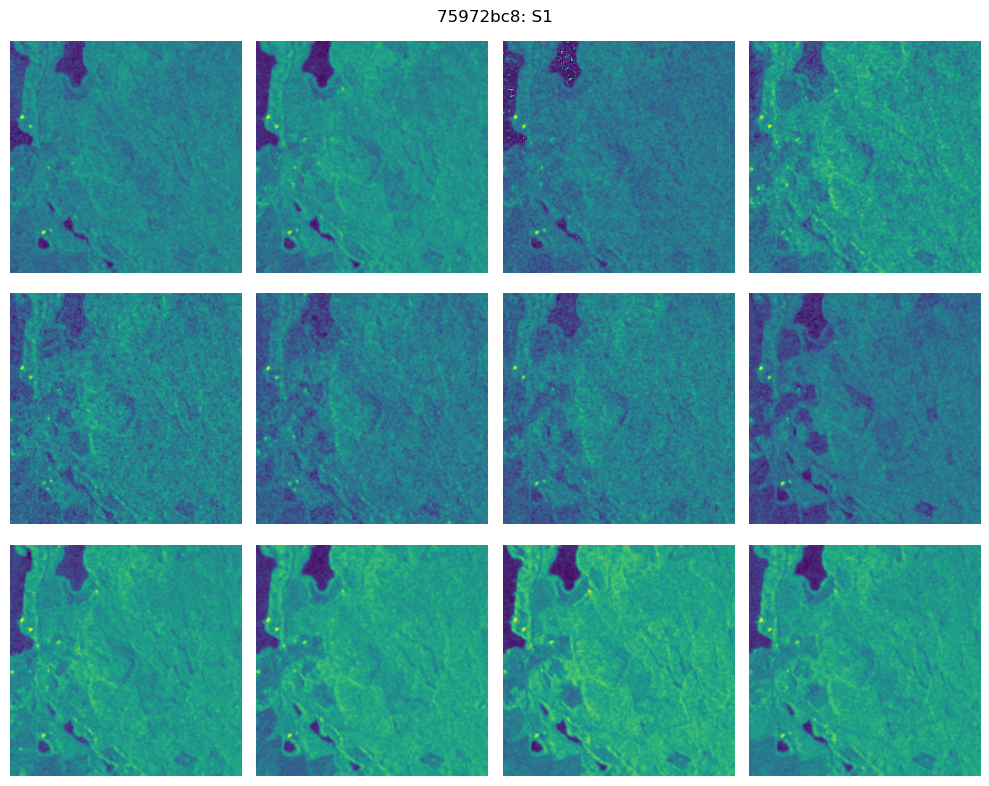

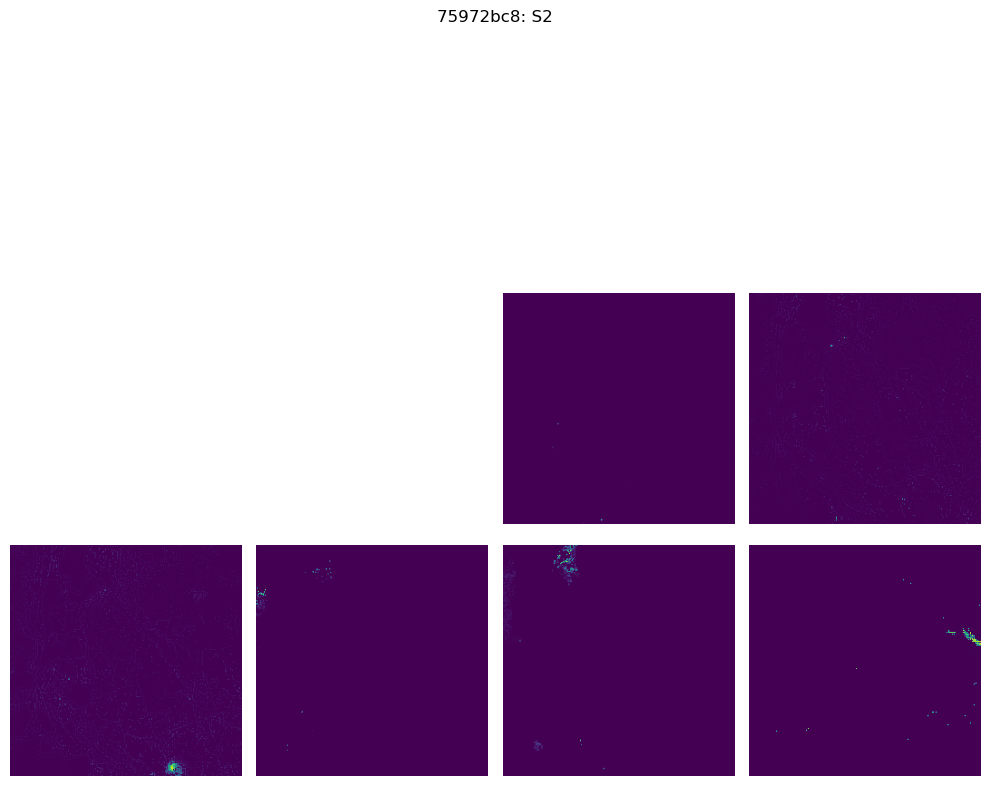

------------------------------------------------------------------------------------------


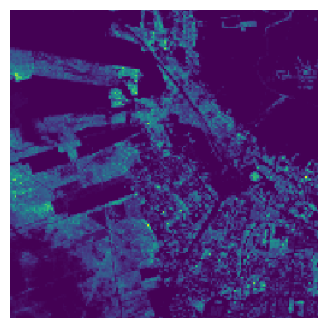

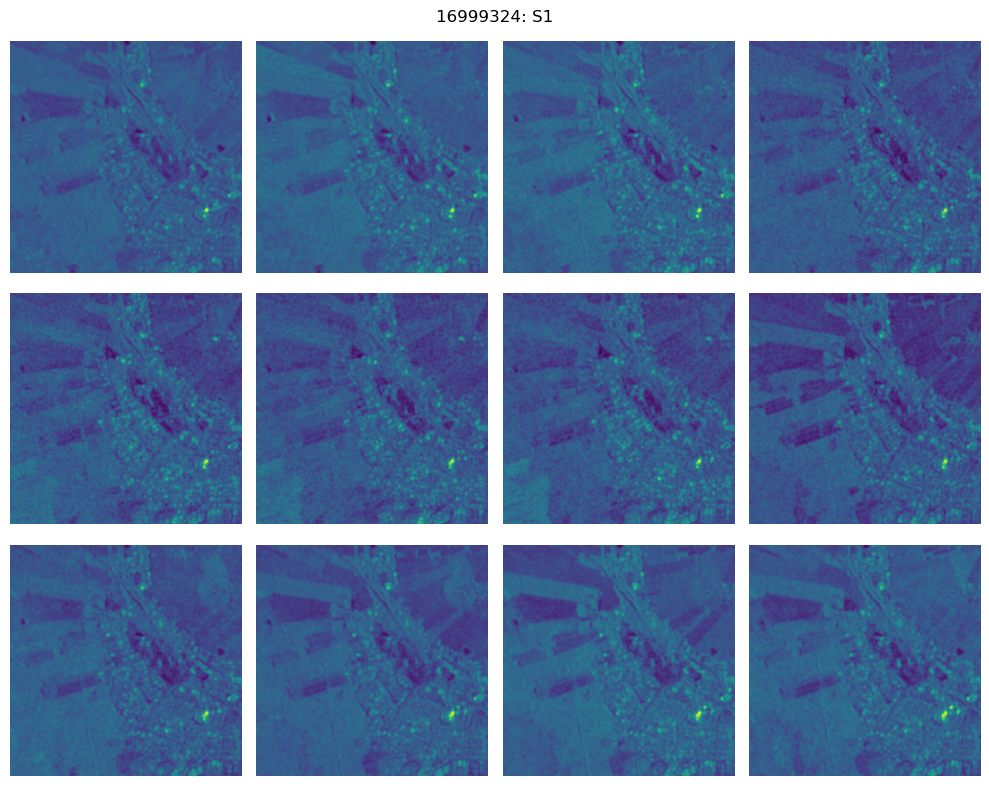

/tmp/ipykernel_4014963/1774939680.py:8: RuntimeWarning: invalid value encountered in divide
/tmp/ipykernel_4014963/1774939680.py:11: RuntimeWarning: invalid value encountered in divide
/tmp/ipykernel_4014963/1774939680.py:8: RuntimeWarning: invalid value encountered in divide
/tmp/ipykernel_4014963/1774939680.py:11: RuntimeWarning: invalid value encountered in divide
/tmp/ipykernel_4014963/1774939680.py:8: RuntimeWarning: invalid value encountered in divide
/tmp/ipykernel_4014963/1774939680.py:11: RuntimeWarning: invalid value encountered in divide
/tmp/ipykernel_4014963/1774939680.py:8: RuntimeWarning: invalid value encountered in divide
/tmp/ipykernel_4014963/1774939680.py:8: RuntimeWarning: invalid value encountered in divide
/tmp/ipykernel_4014963/1774939680.py:11: RuntimeWarning: invalid value encountered in divide
/tmp/ipykernel_4014963/1774939680.py:8: RuntimeWarning: invalid value encountered in divide
/tmp/ipykernel_4014963/1774939680.py:8: RuntimeWarning: invalid value encoun

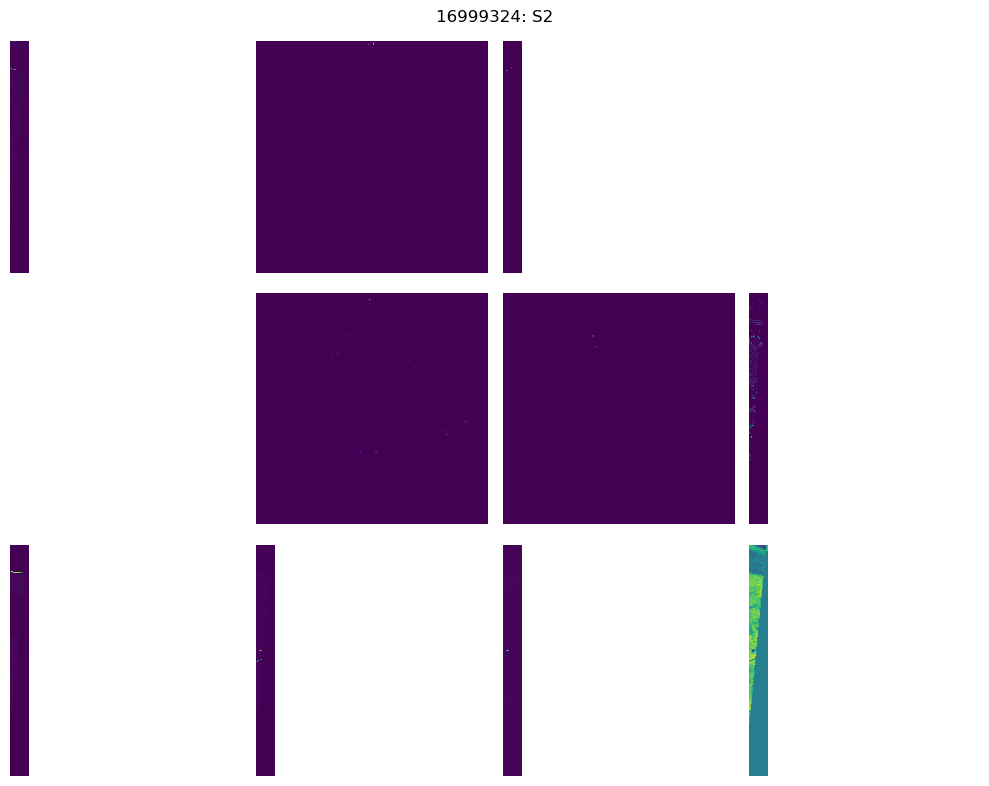

------------------------------------------------------------------------------------------


In [116]:
for chip_id in train_df.sample(10).chip_id.unique():
    g = train_df[train_df.chip_id==chip_id]
    
    agbm_data = g.corresponding_agbm.map(lambda x: os.path.join(data_folder, 'train_agbm/'+x)).unique()
    assert len(agbm_data)==1

    agbm_data = io.imread(agbm_data[0])
    plt.figure(figsize=(4, 4))
    plt.imshow(agbm_data)
    plt.axis('off')
    plt.show()
    
    plot_months(g, 'S1', 0)
    plot_months(g, 'S2', 11)
    
    print('------------------------------------------------------------------------------------------')
    

In [135]:
chip_id = train_df.sample(1).chip_id.unique()[0]
chip_id

'686677b5'

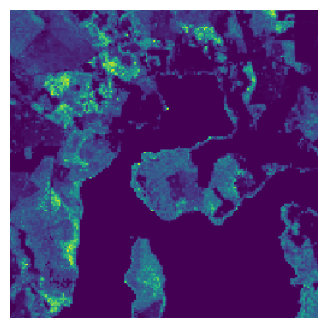

In [136]:
g = train_df[train_df.chip_id==chip_id]
    
agbm_data = g.corresponding_agbm.map(lambda x: os.path.join(data_folder, 'train_agbm/'+x)).unique()
assert len(agbm_data)==1

agbm_data = io.imread(agbm_data[0])
plt.figure(figsize=(4, 4))
plt.imshow(agbm_data)
plt.axis('off')
plt.show()

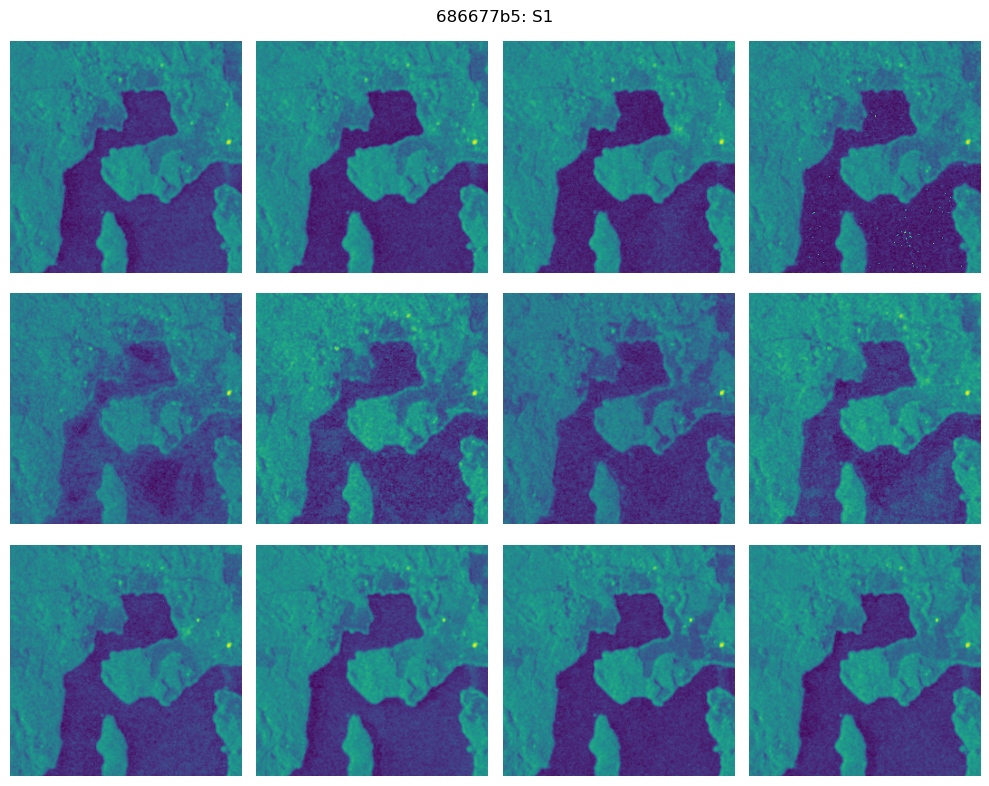

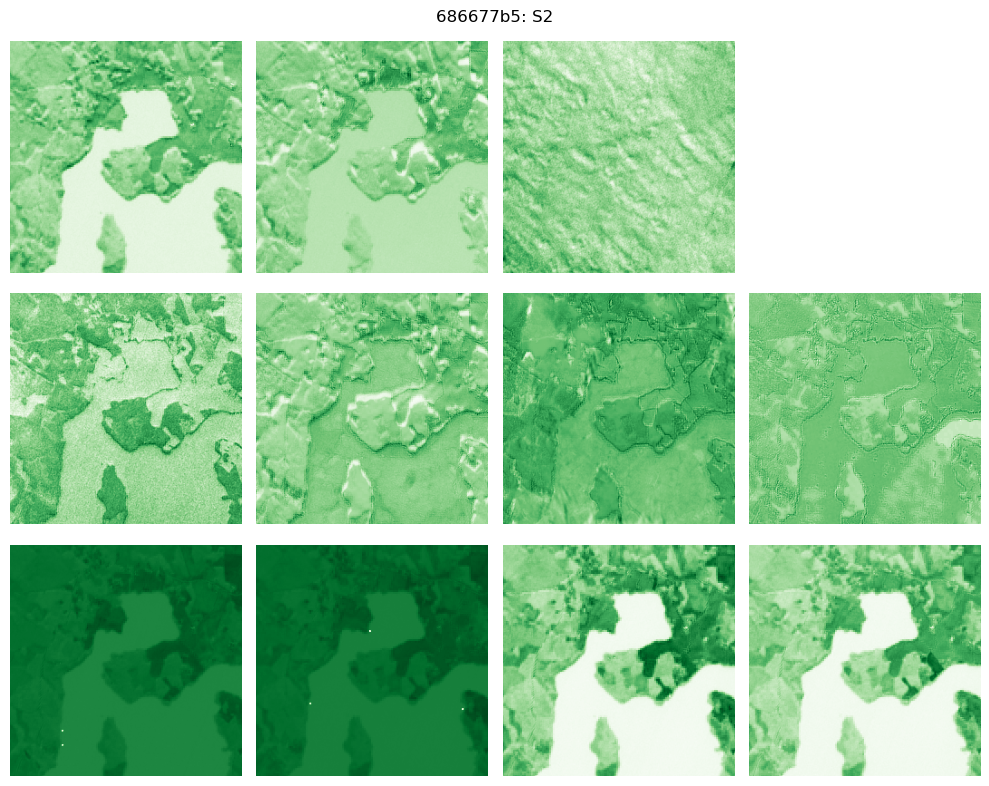

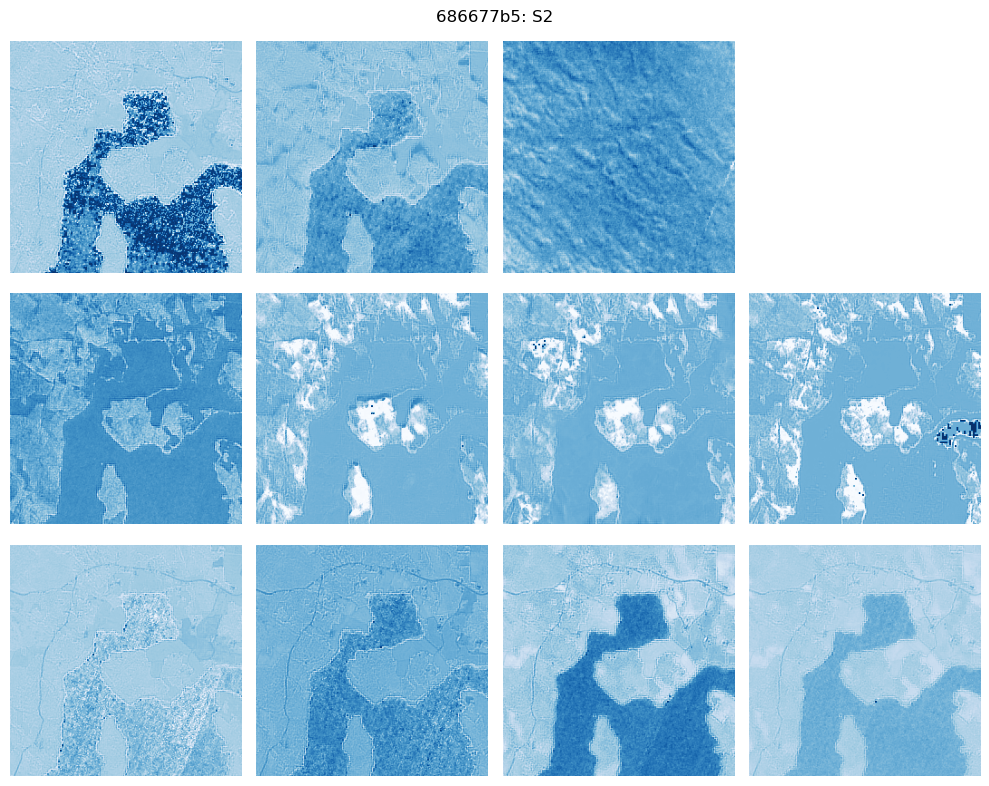

In [139]:
plot_months(g, 'S1', 0)
plot_months(g, 'S2', 13, cmap='Greens')
plot_months(g, 'S2', 12, cmap='Blues')